In [1]:
import os
from os.path import isfile, join
import shutil
from tqdm import tqdm
import time
from imageio import imread

# Preparing DF with image arrays, file info and categories

In [2]:
import pandas as pd
import numpy as np
execution_path = os.getcwd()
#os.listdir(foodd_dir)
def findfiles_DF(rootpath):
    fillist = []
    for subel in os.listdir(rootpath):
        try:
            if isfile(join(rootpath,subel)):
                #print(join(rootpath,subel))
                fullpath = join(rootpath,subel)
                img = imread(fullpath)
                if img.shape[0]*img.shape[1] > 0:
                    ratio = np.maximum(img.shape[0]/img.shape[1],img.shape[1]/img.shape[0])
                    fillist.append([fullpath,subel,img,img.shape[0]*img.shape[1],img.shape[0],img.shape[1],ratio])
                else:
                    fillist.append([fullpath,subel,img,[0],0,0,1000])
            else:
                fillist.extend(findfiles_DF(join(rootpath,subel)))
        except ValueError:
            print(subel)
    #fillDF = pd.DataFrame(fillist, columns = collist)
    return fillist
#foodd_list = findfiles(foodd_dir)
#print(foodd_list)

In [3]:
foodd_dir = '''D:\PROGRAMMING_PROJS\FooDMachineLearning\FooDD'''
dest_dir = '''D:\PROGRAMMING_PROJS\FooDMachineLearning\FoodMLrepo\FoodML\images'''
ecustfd_dir = '''D:\PROGRAMMING_PROJS\FooDMachineLearning\ECUSTFD-resized--master\JPEGImages'''
complete_dir = '''D:\PROGRAMMING_PROJS\FooDMachineLearning\complete_dataset'''

In [4]:
foodd_l = findfiles_DF(complete_dir)
collist = ['Path','FileName','ImageArray','FullSize2D','Height','Width','Ratio']
try:
    fillDF = pd.DataFrame(foodd_l, columns = collist)
except TypeError:
    print('bazinga')
fillDF.head()

apple-14.jpg
toilet-1.jpg
apple-4.jpg
vase-1.jpg
pizza-5.jpg
dining table-2.jpg
donut-2.jpg


,Path,FileName,ImageArray,FullSize2D,Height,Width,Ratio
0,D:\PROGRAMMING_PROJS\FooDMachineLearning\compl...,0_PROGRAMMING_PROJS_FooDMachineLearning_FooDD_...,"[[[95, 88, 59], [109, 102, 74], [113, 106, 80]...",22400,112,200,1.785714
1,D:\PROGRAMMING_PROJS\FooDMachineLearning\compl...,1000_PROGRAMMING_PROJS_FooDMachineLearning_Foo...,"[[[59, 39, 30], [67, 47, 36], [65, 43, 30], [6...",30000,150,200,1.333333
2,D:\PROGRAMMING_PROJS\FooDMachineLearning\compl...,1001_PROGRAMMING_PROJS_FooDMachineLearning_Foo...,"[[[113, 112, 108], [102, 101, 99], [106, 105, ...",30000,150,200,1.333333
3,D:\PROGRAMMING_PROJS\FooDMachineLearning\compl...,1002_PROGRAMMING_PROJS_FooDMachineLearning_Foo...,"[[[206, 210, 222], [207, 211, 223], [206, 210,...",30000,150,200,1.333333
4,D:\PROGRAMMING_PROJS\FooDMachineLearning\compl...,1003_PROGRAMMING_PROJS_FooDMachineLearning_Foo...,"[[[172, 179, 187], [193, 200, 208], [199, 206,...",30000,150,200,1.333333


In [5]:
fillDF.shape

(7426, 7)

In [6]:
fillDF.describe()

,FullSize2D,Height,Width,Ratio
count,7426.000000,7426.000000,7426.000000,7426.000000
mean,29022.880420,147.622946,194.042688,1.446802
std,10166.442669,45.486651,26.279204,0.230812
min,196.000000,14.000000,14.000000,1.000000
25%,22600.000000,113.000000,200.000000,1.333333
50%,30000.000000,150.000000,200.000000,1.333333
75%,30000.000000,150.000000,200.000000,1.769912
max,139502.000000,373.000000,374.000000,3.400000


In [7]:
fillDF[fillDF['FullSize2D']==fillDF['FullSize2D'].max()]

,Path,FileName,ImageArray,FullSize2D,Height,Width,Ratio
7112,D:\PROGRAMMING_PROJS\FooDMachineLearning\compl...,sports ball-1.jpg,"[[[255, 255, 255], [255, 255, 255], [255, 255,...",139502,373,374,1.002681


In [8]:
fillDF[fillDF['FullSize2D']==fillDF['FullSize2D'].min()]['Path']

643    D:\PROGRAMMING_PROJS\FooDMachineLearning\compl...
Name: Path, dtype: object

In [9]:
import re
def strprep(s):
    s = s.replace(complete_dir+'\\','')
    #print(s)
    m = re.search('[0-9]+_PROGRAMMING_PROJS_FooDMachineLearning_FooDD_|[0-9]+_PROGRAMMING_PROJS_FooDMachineLearning_ECUSTFD-resized--master_JPEGImages|[0-9]+',s)
    return s.replace(m.group(0),'')
fillDF['W/o common'] = fillDF['Path'].apply(lambda x: strprep(x))
#fillDF['W/o common'] = fillDF['W/o common'].apply(lambda x: x.replace(complete_dir+'\\',''))
fillDF.head()

,Path,FileName,ImageArray,FullSize2D,Height,Width,Ratio,W/o common
0,D:\PROGRAMMING_PROJS\FooDMachineLearning\compl...,0_PROGRAMMING_PROJS_FooDMachineLearning_FooDD_...,"[[[95, 88, 59], [109, 102, 74], [113, 106, 80]...",22400,112,200,1.785714,Apple_1-Samsung-S4-Light__Environment_1__(1)_j...
1,D:\PROGRAMMING_PROJS\FooDMachineLearning\compl...,1000_PROGRAMMING_PROJS_FooDMachineLearning_Foo...,"[[[59, 39, 30], [67, 47, 36], [65, 43, 30], [6...",30000,150,200,1.333333,Bread_3-IOS-4-Light__Environment_3__(60)_jpg3_...
2,D:\PROGRAMMING_PROJS\FooDMachineLearning\compl...,1001_PROGRAMMING_PROJS_FooDMachineLearning_Foo...,"[[[113, 112, 108], [102, 101, 99], [106, 105, ...",30000,150,200,1.333333,Bread_3-IOS-4-Light__Environment_3__(61)_jpg3_...
3,D:\PROGRAMMING_PROJS\FooDMachineLearning\compl...,1002_PROGRAMMING_PROJS_FooDMachineLearning_Foo...,"[[[206, 210, 222], [207, 211, 223], [206, 210,...",30000,150,200,1.333333,Bread_3-IOS-4-Light__Environment_3__(62)_jpg3_...
4,D:\PROGRAMMING_PROJS\FooDMachineLearning\compl...,1003_PROGRAMMING_PROJS_FooDMachineLearning_Foo...,"[[[172, 179, 187], [193, 200, 208], [199, 206,...",30000,150,200,1.333333,Bread_3-IOS-4-Light__Environment_3__(63)_jpg3_...


In [10]:
fillDF['W/o common'].head()

0    Apple_1-Samsung-S4-Light__Environment_1__(1)_j...
1    Bread_3-IOS-4-Light__Environment_3__(60)_jpg3_...
2    Bread_3-IOS-4-Light__Environment_3__(61)_jpg3_...
3    Bread_3-IOS-4-Light__Environment_3__(62)_jpg3_...
4    Bread_3-IOS-4-Light__Environment_3__(63)_jpg3_...
Name: W/o common, dtype: object

In [11]:
import re
def extractStr(s,pos):
    if pos < 1:
        m = re.search('([a-zA-Z]+)',s)
    else:
        m = re.search('([a-zA-Z]+)(__)([a-zA-Z]+)(_)([a-zA-Z]+)',s)
    return m.group(pos)
fillDF['ProdName'] = fillDF['W/o common'].apply(lambda x: extractStr(x,0))
fillDF.head()

,Path,FileName,ImageArray,FullSize2D,Height,Width,Ratio,W/o common,ProdName
0,D:\PROGRAMMING_PROJS\FooDMachineLearning\compl...,0_PROGRAMMING_PROJS_FooDMachineLearning_FooDD_...,"[[[95, 88, 59], [109, 102, 74], [113, 106, 80]...",22400,112,200,1.785714,Apple_1-Samsung-S4-Light__Environment_1__(1)_j...,Apple
1,D:\PROGRAMMING_PROJS\FooDMachineLearning\compl...,1000_PROGRAMMING_PROJS_FooDMachineLearning_Foo...,"[[[59, 39, 30], [67, 47, 36], [65, 43, 30], [6...",30000,150,200,1.333333,Bread_3-IOS-4-Light__Environment_3__(60)_jpg3_...,Bread
2,D:\PROGRAMMING_PROJS\FooDMachineLearning\compl...,1001_PROGRAMMING_PROJS_FooDMachineLearning_Foo...,"[[[113, 112, 108], [102, 101, 99], [106, 105, ...",30000,150,200,1.333333,Bread_3-IOS-4-Light__Environment_3__(61)_jpg3_...,Bread
3,D:\PROGRAMMING_PROJS\FooDMachineLearning\compl...,1002_PROGRAMMING_PROJS_FooDMachineLearning_Foo...,"[[[206, 210, 222], [207, 211, 223], [206, 210,...",30000,150,200,1.333333,Bread_3-IOS-4-Light__Environment_3__(62)_jpg3_...,Bread
4,D:\PROGRAMMING_PROJS\FooDMachineLearning\compl...,1003_PROGRAMMING_PROJS_FooDMachineLearning_Foo...,"[[[172, 179, 187], [193, 200, 208], [199, 206,...",30000,150,200,1.333333,Bread_3-IOS-4-Light__Environment_3__(63)_jpg3_...,Bread


In [12]:
(fillDF['ProdName'].unique())

array(['Apple', 'Bread', 'grapefruit', 'apple', 'Carrot', 'grapes',
       'green', 'guava', 'Cheese', 'kiwi', 'lemon', 'lemone', 'lentils',
       'Cucumber', 'lettuce', 'mandarin', 'mango', 'melon', 'Egg',
       'mushrooms', 'olive', 'onion', 'orang', 'orange', 'Grape',
       'papaya', 'peach', 'pear', 'apricot', 'pineapple', 'pomegranate',
       'Net', 'potato', 'radish', 'raspberry', 'red', 'rice',
       'strawberry', 'sweet', 'Onion', 'tomato', 'watermelon', 'white',
       'zucchini', 'Orange', 'aubergine', 'Pasta', 'Pepper', 'Qiwi',
       'sauce', 'avocado', 'Tomato', 'Watermelon', 'banana', 'beetroot',
       'Banana', 'bread', 'bun', 'doughnut', 'cabbage', 'egg', 'fired',
       'grape', 'litchi', 'mix', 'Bean', 'mooncake', 'carrot',
       'cauliflower', 'cherry', 'plum', 'qiwi', 'chili', 'sachima',
       'coconut', 'corn', 'cucumber', 'dates', 'fig', 'FriedChicken',
       'garlic', 'ginger'], dtype=object)

In [13]:
fillDF['ProdName'].value_counts()

Apple           435
apple           404
Onion           328
Bean            279
orange          276
Tomato          274
Bread           268
Egg             267
Cheese          259
Net             254
Orange          235
mango           226
sauce           210
doughnut        210
Pasta           207
pear            180
lemon           179
banana          178
tomato          178
plum            176
Grape           164
sachima         150
mooncake        134
peach           134
fired           124
Cucumber        121
qiwi            120
Banana          119
mix             108
egg             107
               ... 
pineapple        10
garlic           10
cabbage          10
coconut           9
guava             9
carrot            8
cauliflower       7
cucumber          6
orang             6
zucchini          6
cherry            6
ginger            6
green             5
fig               5
chili             5
white             5
corn              4
strawberry        4
lentils           4


In [14]:
sss='Net__images_pineapple__2_pngpineapple__2'
extractStr(sss,5)

'pineapple'

In [15]:
fillDF.loc[fillDF['ProdName']=='Net']
fillDF.loc[fillDF['ProdName']=='Net','ProdName'] = fillDF.loc[fillDF['ProdName']=='Net']['W/o common'].apply(lambda x: extractStr(x,5))
fillDF['ProdName'].value_counts()

Apple             435
apple             421
Onion             328
orange            280
Bean              279
Tomato            274
Bread             268
Egg               267
Cheese            259
Orange            235
mango             229
doughnut          210
sauce             210
Pasta             207
lemon             190
pear              184
tomato            181
banana            178
plum              176
Grape             164
sachima           150
peach             137
mooncake          134
fired             124
Cucumber          122
qiwi              120
Banana            119
egg               109
mix               108
Carrot             96
                 ... 
carrot             10
cauliflower        10
chili              10
green               9
ginger              9
cherry              9
strawberry          9
cucumber            8
orang               8
corn                7
white               7
fig                 7
lentils             6
lettuce             6
raspberry 

In [16]:
fillDF['ProdName'].unique()

array(['Apple', 'Bread', 'grapefruit', 'apple', 'Carrot', 'grapes',
       'green', 'guava', 'Cheese', 'kiwi', 'lemon', 'lemone', 'lentils',
       'Cucumber', 'lettuce', 'mandarin', 'mango', 'melon', 'Egg',
       'mushrooms', 'olive', 'onion', 'orang', 'orange', 'Grape',
       'papaya', 'peach', 'pear', 'apricot', 'pineapple', 'pomegranate',
       'aubergine', 'avocado', 'beetroot', 'bread', 'potato', 'cabbage',
       'radish', 'carrot', 'cauliflower', 'cherry', 'raspberry', 'chili',
       'coconut', 'corn', 'cucumber', 'dates', 'egg', 'fig',
       'FriedChicken', 'garlic', 'ginger', 'red', 'imagesCAKOFJ',
       'imagesCAVUTOFK', 'IMG', 'rice', 'okra', 'strawberry', 'sweet',
       'spinach', 'tomato', 'untitled', 'watermelon', 'white', 'zucchini',
       'Onion', 'Orange', 'Pasta', 'Pepper', 'Qiwi', 'sauce', 'Tomato',
       'Watermelon', 'banana', 'Banana', 'bun', 'doughnut', 'fired',
       'grape', 'litchi', 'mix', 'Bean', 'mooncake', 'plum', 'qiwi',
       'sachima'], dtyp

In [17]:
import matplotlib.pyplot as plt
import numpy as np
import random
def drawImgs(fsiz,imgs,rows_num,cols_num):
    fig = plt.figure(figsize=(fsiz,fsiz))
    for img, i in zip(imgs,range(1,imgs.size+1)):
        fig.add_subplot(rows_num,cols_num, i)
        plt.imshow(img)
    plt.show()
def showRandImgs(df,catcol,imgcol,cat):
    imgs = df.loc[df[catcol]==cat,imgcol]
    imgs_num = imgs.size
    if imgs_num > 50:
        imgs = imgs.sample(n=50)
        imgs_num = imgs.size
    fsiz = np.ceil(imgs_num*2)
    cols_num = 5
    rows_num = np.ceil(imgs_num/cols_num)
    drawImgs(fsiz,imgs,rows_num,cols_num)
def showImgsCat(cat):
    showRandImgs(fillDF,'ProdName','ImageArray',cat)
def showImgPth(df,pth):
    vals = df.loc[df['Path']==pth,'ImageArray'].values
    for img in vals:
        plt.imshow(img)
        plt.show()
def showImg(record):
    vals = record['ImageArray'].values
    for img in vals:
        plt.imshow(img)
        plt.show()

In [18]:
np.ceil(10/3)

4.0

In [19]:
type(fillDF.loc[fillDF['ProdName']=='rice','Ratio'])

pandas.core.series.Series

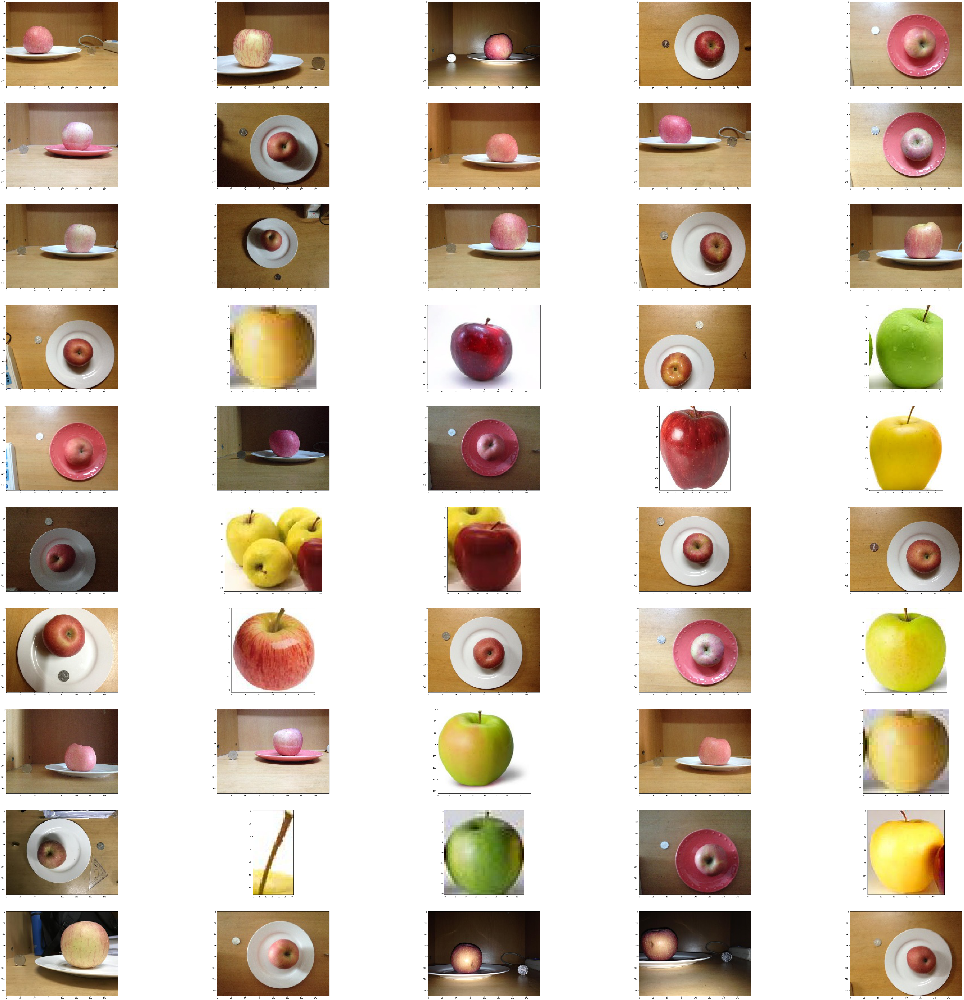

In [20]:
showRandImgs(fillDF,'ProdName','ImageArray','apple')

In [21]:
fillDF[fillDF['Ratio']==fillDF['Ratio'].max()]

,Path,FileName,ImageArray,FullSize2D,Height,Width,Ratio,W/o common,ProdName
1983,D:\PROGRAMMING_PROJS\FooDMachineLearning\compl...,banana-2.jpg,"[[[96, 132, 88], [66, 101, 61], [43, 77, 44], ...",8500,170,50,3.4,white__radish__1.png-objects\banana-2.jpg,white


In [22]:
type(fillDF[fillDF['Ratio']==fillDF['Ratio'].max()]['ImageArray'].values)

numpy.ndarray

<class 'numpy.ndarray'>
(170, 50, 3)
[Image([[[ 96, 132,  88],
        [ 66, 101,  61],
        [ 43,  77,  44],
        ...,
        [ 38,  66,  54],
        [  7,  41,  89],
        [  7,  41,  89]],

       [[ 92, 128,  84],
        [ 62,  97,  55],
        [ 44,  75,  41],
        ...,
        [ 29,  56,  51],
        [  7,  41,  89],
        [  7,  41,  89]],

       [[ 91, 124,  79],
        [ 58,  91,  48],
        [ 41,  73,  34],
        ...,
        [ 19,  47,  50],
        [  7,  40,  91],
        [  7,  40,  91]],

       ...,

       [[ 10,  49, 128],
        [  9,  48, 127],
        [  8,  47, 124],
        ...,
        [  0,  22,  58],
        [  0,  30,  77],
        [  0,  31,  78]],

       [[  7,  45, 126],
        [  6,  45, 124],
        [  6,  45, 122],
        ...,
        [  0,  26,  63],
        [  4,  37,  88],
        [  4,  37,  88]],

       [[  7,  45, 126],
        [  6,  44, 125],
        [  6,  45, 124],
        ...,
        [  0,  29,  67],
        [  

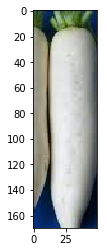

In [23]:
ss = fillDF[fillDF['Ratio']==fillDF['Ratio'].max()]['ImageArray'].values
print(type(ss))
print(ss[0].shape)
print(ss)
plt.imshow(ss[0])
plt.show()

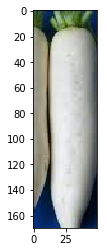

In [24]:
showImg(fillDF[fillDF['Ratio']==fillDF['Ratio'].max()])

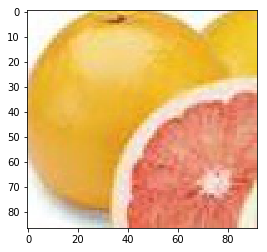

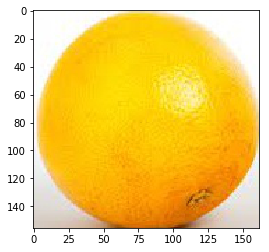

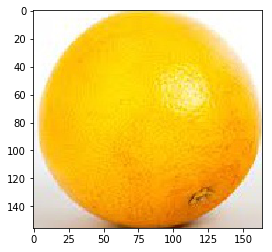

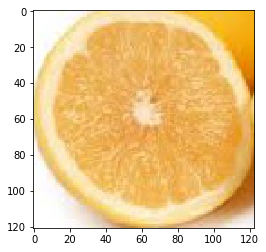

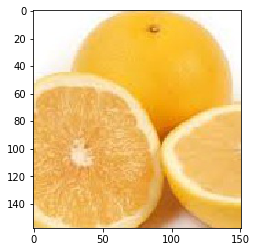

...

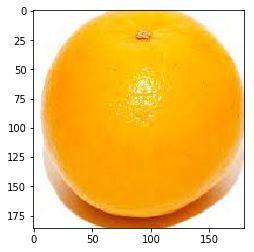

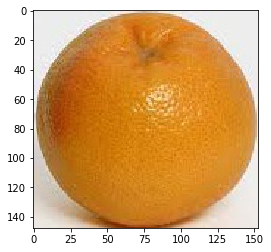

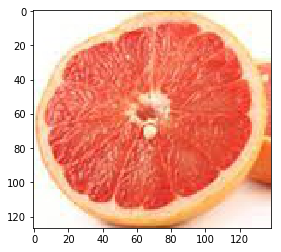

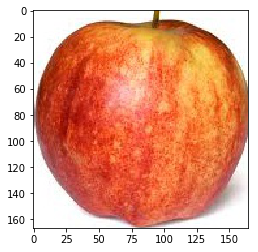

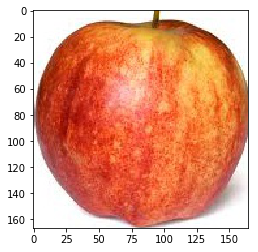

In [25]:
showImg(fillDF[fillDF['Ratio']<1.1])

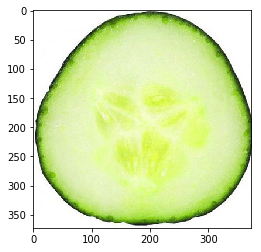

In [26]:
showImg(fillDF[fillDF['FullSize2D']==fillDF['FullSize2D'].max()])

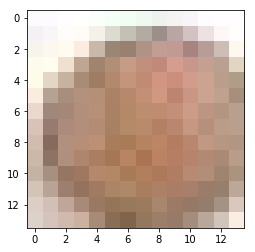

In [27]:
showImg(fillDF[fillDF['FullSize2D']==fillDF['FullSize2D'].min()])

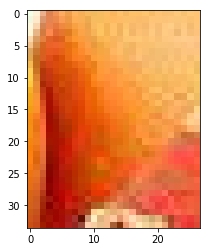

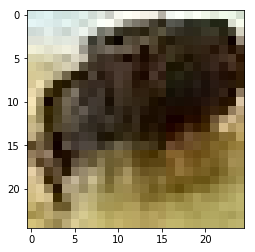

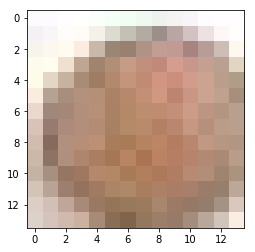

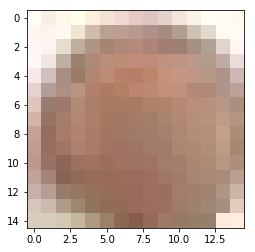

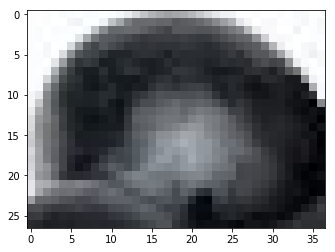

...

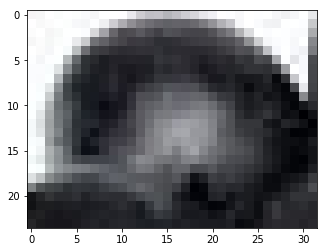

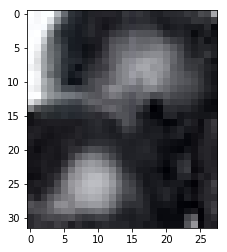

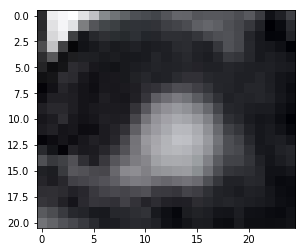

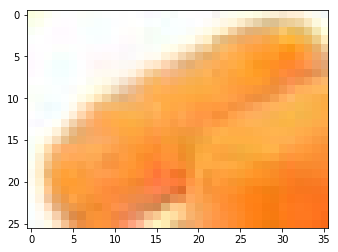

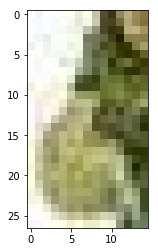

In [28]:
showImg(fillDF[fillDF['FullSize2D']<1000])

In [29]:
fillDF['ProdName'] = fillDF['ProdName'].apply(lambda x: x.upper())
fillDF.head()

,Path,FileName,ImageArray,FullSize2D,Height,Width,Ratio,W/o common,ProdName
0,D:\PROGRAMMING_PROJS\FooDMachineLearning\compl...,0_PROGRAMMING_PROJS_FooDMachineLearning_FooDD_...,"[[[95, 88, 59], [109, 102, 74], [113, 106, 80]...",22400,112,200,1.785714,Apple_1-Samsung-S4-Light__Environment_1__(1)_j...,APPLE
1,D:\PROGRAMMING_PROJS\FooDMachineLearning\compl...,1000_PROGRAMMING_PROJS_FooDMachineLearning_Foo...,"[[[59, 39, 30], [67, 47, 36], [65, 43, 30], [6...",30000,150,200,1.333333,Bread_3-IOS-4-Light__Environment_3__(60)_jpg3_...,BREAD
2,D:\PROGRAMMING_PROJS\FooDMachineLearning\compl...,1001_PROGRAMMING_PROJS_FooDMachineLearning_Foo...,"[[[113, 112, 108], [102, 101, 99], [106, 105, ...",30000,150,200,1.333333,Bread_3-IOS-4-Light__Environment_3__(61)_jpg3_...,BREAD
3,D:\PROGRAMMING_PROJS\FooDMachineLearning\compl...,1002_PROGRAMMING_PROJS_FooDMachineLearning_Foo...,"[[[206, 210, 222], [207, 211, 223], [206, 210,...",30000,150,200,1.333333,Bread_3-IOS-4-Light__Environment_3__(62)_jpg3_...,BREAD
4,D:\PROGRAMMING_PROJS\FooDMachineLearning\compl...,1003_PROGRAMMING_PROJS_FooDMachineLearning_Foo...,"[[[172, 179, 187], [193, 200, 208], [199, 206,...",30000,150,200,1.333333,Bread_3-IOS-4-Light__Environment_3__(63)_jpg3_...,BREAD


In [30]:
fillDF['ProdName'].unique()

array(['APPLE', 'BREAD', 'GRAPEFRUIT', 'CARROT', 'GRAPES', 'GREEN',
       'GUAVA', 'CHEESE', 'KIWI', 'LEMON', 'LEMONE', 'LENTILS',
       'CUCUMBER', 'LETTUCE', 'MANDARIN', 'MANGO', 'MELON', 'EGG',
       'MUSHROOMS', 'OLIVE', 'ONION', 'ORANG', 'ORANGE', 'GRAPE',
       'PAPAYA', 'PEACH', 'PEAR', 'APRICOT', 'PINEAPPLE', 'POMEGRANATE',
       'AUBERGINE', 'AVOCADO', 'BEETROOT', 'POTATO', 'CABBAGE', 'RADISH',
       'CAULIFLOWER', 'CHERRY', 'RASPBERRY', 'CHILI', 'COCONUT', 'CORN',
       'DATES', 'FIG', 'FRIEDCHICKEN', 'GARLIC', 'GINGER', 'RED',
       'IMAGESCAKOFJ', 'IMAGESCAVUTOFK', 'IMG', 'RICE', 'OKRA',
       'STRAWBERRY', 'SWEET', 'SPINACH', 'TOMATO', 'UNTITLED',
       'WATERMELON', 'WHITE', 'ZUCCHINI', 'PASTA', 'PEPPER', 'QIWI',
       'SAUCE', 'BANANA', 'BUN', 'DOUGHNUT', 'FIRED', 'LITCHI', 'MIX',
       'BEAN', 'MOONCAKE', 'PLUM', 'SACHIMA'], dtype=object)

In [31]:
fillDF['ProdName'].value_counts()

APPLE             856
ORANGE            515
TOMATO            455
EGG               376
ONION             360
BREAD             338
BANANA            297
BEAN              279
CHEESE            259
MANGO             229
GRAPE             222
DOUGHNUT          210
SAUCE             210
PASTA             207
LEMON             190
PEAR              184
QIWI              181
PLUM              176
SACHIMA           150
PEACH             137
MOONCAKE          134
CUCUMBER          130
FIRED             124
MIX               108
CARROT            106
PEPPER             94
BUN                90
WATERMELON         79
LITCHI             78
APRICOT            69
                 ... 
COCONUT            14
ZUCCHINI           13
GUAVA              12
CAULIFLOWER        10
CHILI              10
GREEN               9
CHERRY              9
STRAWBERRY          9
GINGER              9
ORANG               8
WHITE               7
CORN                7
FIG                 7
LENTILS             6
LETTUCE   

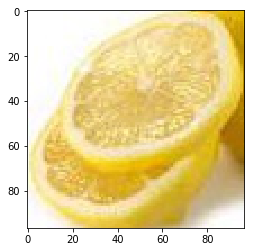

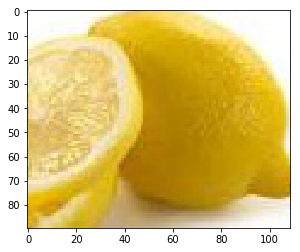

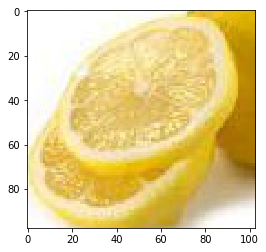

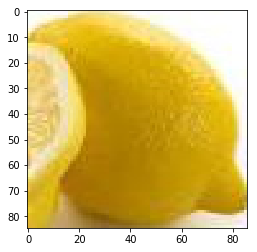

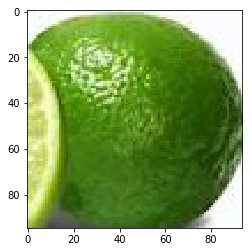

...

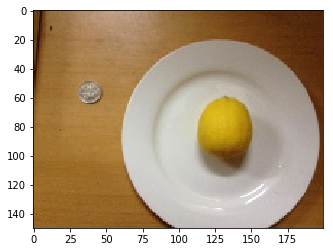

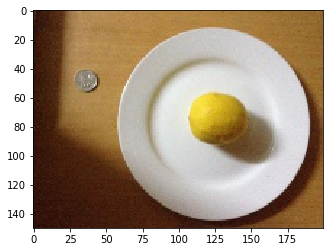

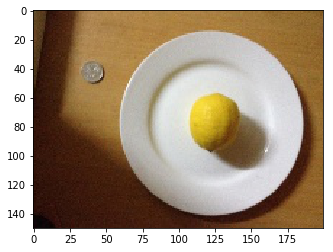

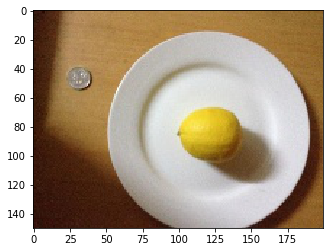

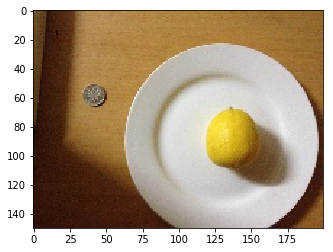

In [32]:
showImg(fillDF[fillDF['ProdName']=='LEMON'])#showImgsCat('LEMON')

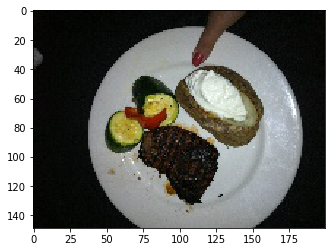

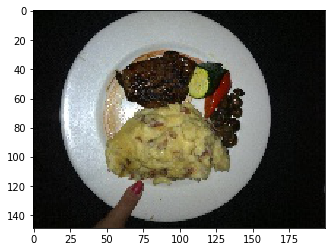

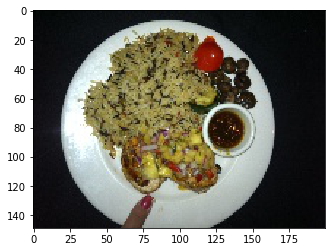

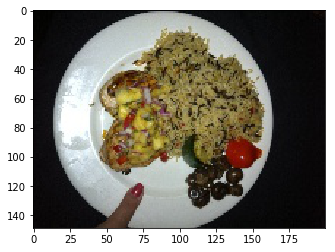

In [33]:
showImg(fillDF[fillDF['ProdName']=='IMG'])

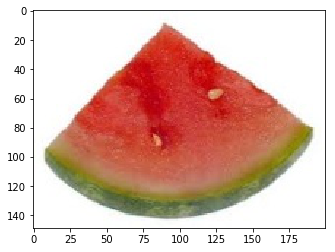

In [34]:
showImg(fillDF[fillDF['ProdName']=='IMAGESCAKOFJ'])

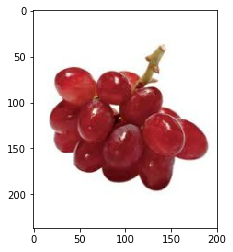

In [35]:
showImg(fillDF[fillDF['ProdName']=='IMAGESCAVUTOFK'])

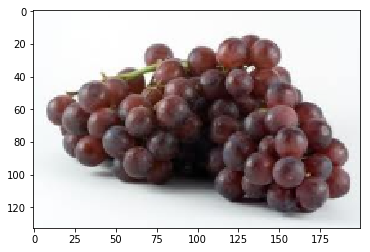

In [36]:
showImg(fillDF[fillDF['ProdName']=='UNTITLED'])

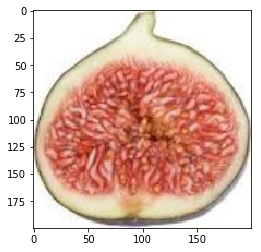

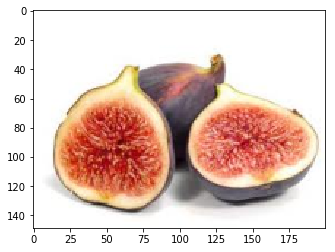

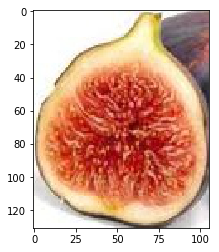

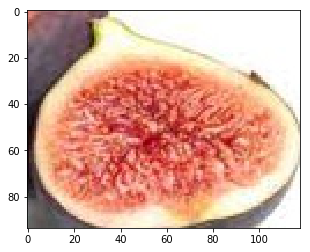

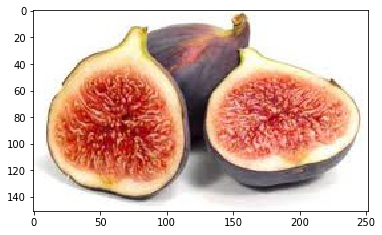

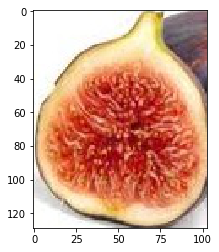

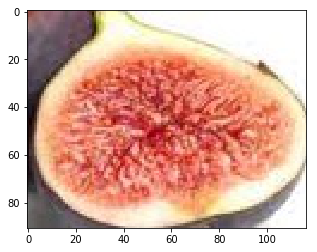

In [37]:
showImg(fillDF[fillDF['ProdName']=='FIG'])

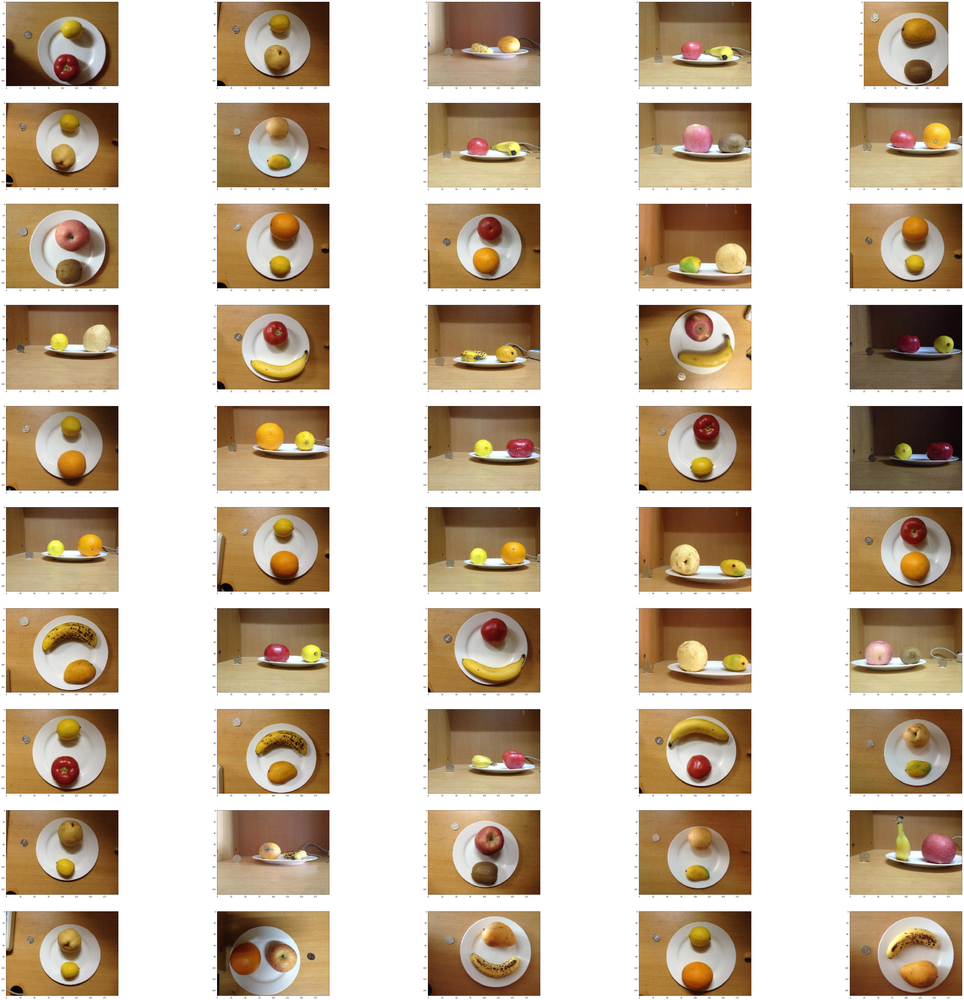

In [38]:
showImgsCat('MIX')

In [39]:
fillDF = fillDF.drop(fillDF[(fillDF.ProdName == 'IMG') | (fillDF.ProdName == 'MIX')].index)
fillDF['ProdName'].unique()

array(['APPLE', 'BREAD', 'GRAPEFRUIT', 'CARROT', 'GRAPES', 'GREEN',
       'GUAVA', 'CHEESE', 'KIWI', 'LEMON', 'LEMONE', 'LENTILS',
       'CUCUMBER', 'LETTUCE', 'MANDARIN', 'MANGO', 'MELON', 'EGG',
       'MUSHROOMS', 'OLIVE', 'ONION', 'ORANG', 'ORANGE', 'GRAPE',
       'PAPAYA', 'PEACH', 'PEAR', 'APRICOT', 'PINEAPPLE', 'POMEGRANATE',
       'AUBERGINE', 'AVOCADO', 'BEETROOT', 'POTATO', 'CABBAGE', 'RADISH',
       'CAULIFLOWER', 'CHERRY', 'RASPBERRY', 'CHILI', 'COCONUT', 'CORN',
       'DATES', 'FIG', 'FRIEDCHICKEN', 'GARLIC', 'GINGER', 'RED',
       'IMAGESCAKOFJ', 'IMAGESCAVUTOFK', 'RICE', 'OKRA', 'STRAWBERRY',
       'SWEET', 'SPINACH', 'TOMATO', 'UNTITLED', 'WATERMELON', 'WHITE',
       'ZUCCHINI', 'PASTA', 'PEPPER', 'QIWI', 'SAUCE', 'BANANA', 'BUN',
       'DOUGHNUT', 'FIRED', 'LITCHI', 'BEAN', 'MOONCAKE', 'PLUM',
       'SACHIMA'], dtype=object)

In [40]:
fillDF['ProdName'].unique()

array(['APPLE', 'BREAD', 'GRAPEFRUIT', 'CARROT', 'GRAPES', 'GREEN',
       'GUAVA', 'CHEESE', 'KIWI', 'LEMON', 'LEMONE', 'LENTILS',
       'CUCUMBER', 'LETTUCE', 'MANDARIN', 'MANGO', 'MELON', 'EGG',
       'MUSHROOMS', 'OLIVE', 'ONION', 'ORANG', 'ORANGE', 'GRAPE',
       'PAPAYA', 'PEACH', 'PEAR', 'APRICOT', 'PINEAPPLE', 'POMEGRANATE',
       'AUBERGINE', 'AVOCADO', 'BEETROOT', 'POTATO', 'CABBAGE', 'RADISH',
       'CAULIFLOWER', 'CHERRY', 'RASPBERRY', 'CHILI', 'COCONUT', 'CORN',
       'DATES', 'FIG', 'FRIEDCHICKEN', 'GARLIC', 'GINGER', 'RED',
       'IMAGESCAKOFJ', 'IMAGESCAVUTOFK', 'RICE', 'OKRA', 'STRAWBERRY',
       'SWEET', 'SPINACH', 'TOMATO', 'UNTITLED', 'WATERMELON', 'WHITE',
       'ZUCCHINI', 'PASTA', 'PEPPER', 'QIWI', 'SAUCE', 'BANANA', 'BUN',
       'DOUGHNUT', 'FIRED', 'LITCHI', 'BEAN', 'MOONCAKE', 'PLUM',
       'SACHIMA'], dtype=object)

In [41]:
fillDF[(fillDF['ProdName'] == 'UNTITLED')| (fillDF['ProdName'] =='IMAGESCAVUTOFK')]

,Path,FileName,ImageArray,FullSize2D,Height,Width,Ratio,W/o common,ProdName
1679,D:\PROGRAMMING_PROJS\FooDMachineLearning\compl...,2266_PROGRAMMING_PROJS_FooDMachineLearning_Foo...,"[[[255, 255, 255], [255, 255, 255], [255, 255,...",47400,237,200,1.185000,Net__images_imagesCAVUTOFK_jpgimagesCAVUTOFK.jpg,IMAGESCAVUTOFK
1853,D:\PROGRAMMING_PROJS\FooDMachineLearning\compl...,2390_PROGRAMMING_PROJS_FooDMachineLearning_Foo...,"[[[252, 253, 255], [252, 253, 255], [252, 253,...",26600,133,200,1.503759,Net__images_untitled_pnguntitled.png,UNTITLED


In [42]:
fillDF.loc[(fillDF['ProdName'] == 'UNTITLED')| (fillDF['ProdName'] =='IMAGESCAVUTOFK'),'ProdName'] = 'GRAPE'

In [43]:
np.sort(fillDF['ProdName'].unique())

array(['APPLE', 'APRICOT', 'AUBERGINE', 'AVOCADO', 'BANANA', 'BEAN',
       'BEETROOT', 'BREAD', 'BUN', 'CABBAGE', 'CARROT', 'CAULIFLOWER',
       'CHEESE', 'CHERRY', 'CHILI', 'COCONUT', 'CORN', 'CUCUMBER',
       'DATES', 'DOUGHNUT', 'EGG', 'FIG', 'FIRED', 'FRIEDCHICKEN',
       'GARLIC', 'GINGER', 'GRAPE', 'GRAPEFRUIT', 'GRAPES', 'GREEN',
       'GUAVA', 'IMAGESCAKOFJ', 'KIWI', 'LEMON', 'LEMONE', 'LENTILS',
       'LETTUCE', 'LITCHI', 'MANDARIN', 'MANGO', 'MELON', 'MOONCAKE',
       'MUSHROOMS', 'OKRA', 'OLIVE', 'ONION', 'ORANG', 'ORANGE', 'PAPAYA',
       'PASTA', 'PEACH', 'PEAR', 'PEPPER', 'PINEAPPLE', 'PLUM',
       'POMEGRANATE', 'POTATO', 'QIWI', 'RADISH', 'RASPBERRY', 'RED',
       'RICE', 'SACHIMA', 'SAUCE', 'SPINACH', 'STRAWBERRY', 'SWEET',
       'TOMATO', 'WATERMELON', 'WHITE', 'ZUCCHINI'], dtype=object)

In [44]:
fillDF.loc[(fillDF['ProdName'] == 'IMAGESCAKOFJ'),'ProdName'] = 'WATERMELON'
fillDF.loc[(fillDF['ProdName'] == 'LEMONE'),'ProdName'] = 'LEMON'
fillDF.loc[(fillDF['ProdName'] == 'ORANG'),'ProdName'] = 'ORANGE'
fillDF.loc[(fillDF['ProdName'] == 'GRAPES'),'ProdName'] = 'GRAPE'

In [45]:
np.sort(fillDF['ProdName'].unique())

array(['APPLE', 'APRICOT', 'AUBERGINE', 'AVOCADO', 'BANANA', 'BEAN',
       'BEETROOT', 'BREAD', 'BUN', 'CABBAGE', 'CARROT', 'CAULIFLOWER',
       'CHEESE', 'CHERRY', 'CHILI', 'COCONUT', 'CORN', 'CUCUMBER',
       'DATES', 'DOUGHNUT', 'EGG', 'FIG', 'FIRED', 'FRIEDCHICKEN',
       'GARLIC', 'GINGER', 'GRAPE', 'GRAPEFRUIT', 'GREEN', 'GUAVA',
       'KIWI', 'LEMON', 'LENTILS', 'LETTUCE', 'LITCHI', 'MANDARIN',
       'MANGO', 'MELON', 'MOONCAKE', 'MUSHROOMS', 'OKRA', 'OLIVE',
       'ONION', 'ORANGE', 'PAPAYA', 'PASTA', 'PEACH', 'PEAR', 'PEPPER',
       'PINEAPPLE', 'PLUM', 'POMEGRANATE', 'POTATO', 'QIWI', 'RADISH',
       'RASPBERRY', 'RED', 'RICE', 'SACHIMA', 'SAUCE', 'SPINACH',
       'STRAWBERRY', 'SWEET', 'TOMATO', 'WATERMELON', 'WHITE', 'ZUCCHINI'],
      dtype=object)

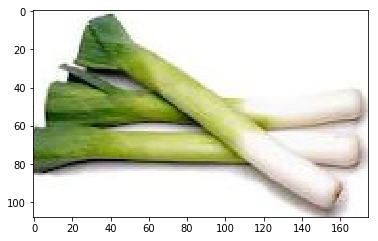

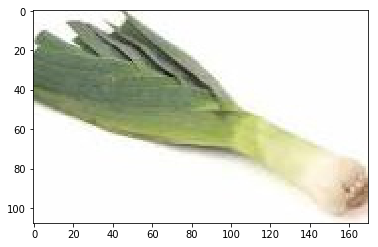

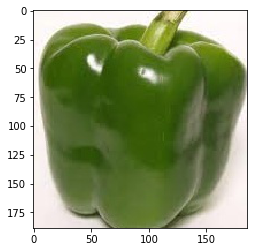

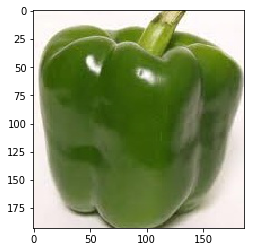

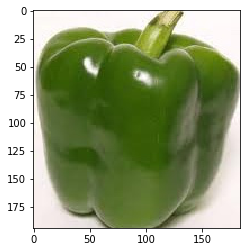

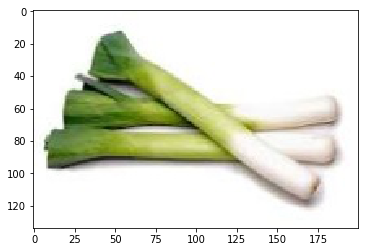

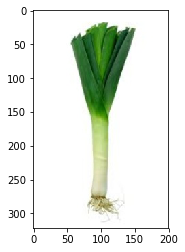

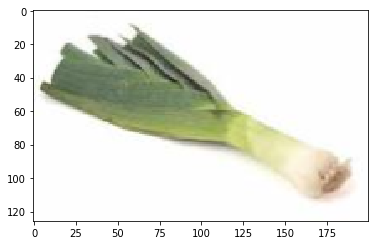

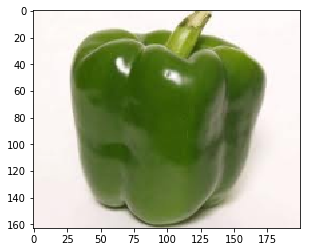

In [46]:
showImg(fillDF[fillDF['ProdName']=='GREEN'])

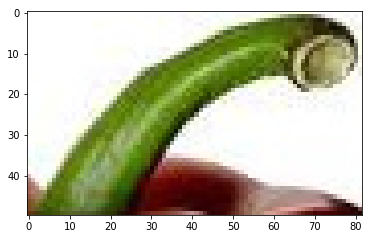

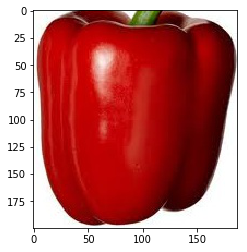

In [47]:
showImg(fillDF[fillDF['ProdName']=='RED'][:2])

In [48]:
dir(fillDF.loc[fillDF['ProdName']=='RED','ProdName'][:2])
fillDF.loc[(fillDF.loc[fillDF['ProdName']=='RED','ProdName'][:2].index.values),'ProdName'] = 'PEPPER'

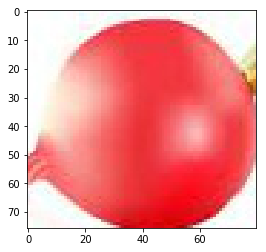

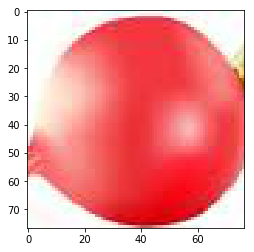

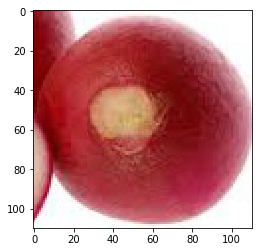

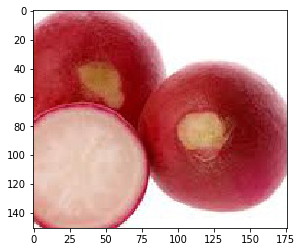

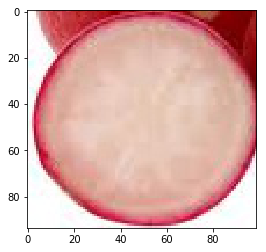

...

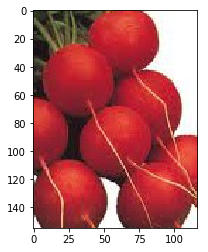

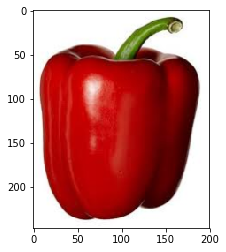

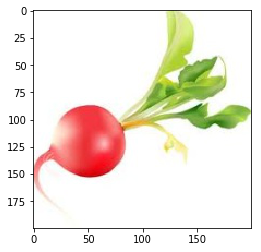

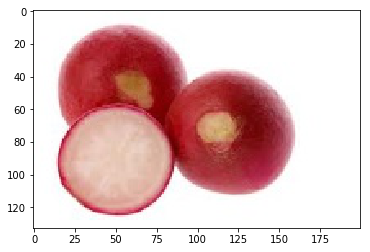

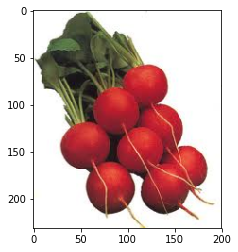

In [49]:
showImg(fillDF[fillDF['ProdName']=='RED'])

In [50]:
fillDF.loc[(fillDF['ProdName'] == 'RED'),'ProdName'] = 'RADISH'

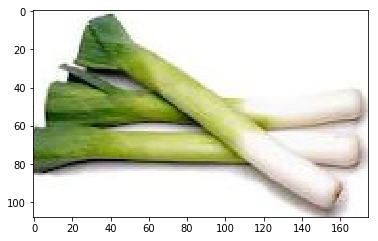

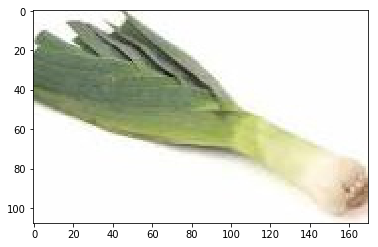

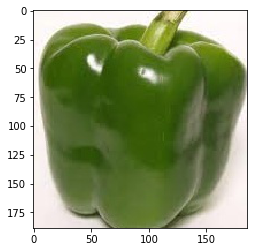

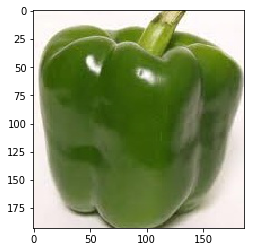

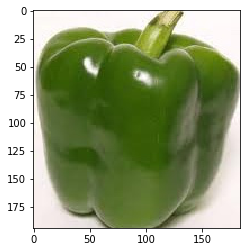

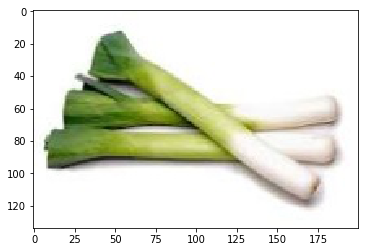

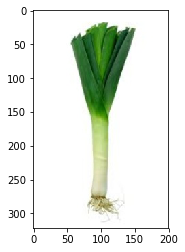

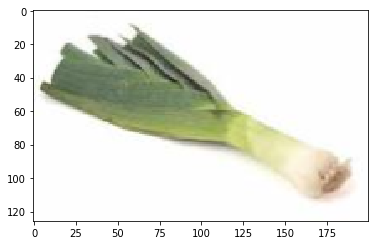

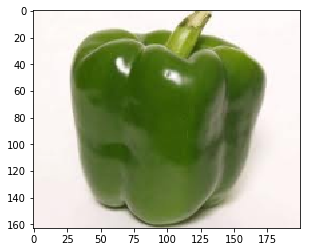

In [51]:
showImg(fillDF[fillDF['ProdName']=='GREEN'])

In [54]:
np.sort(fillDF['ProdName'].unique())

array(['APPLE', 'APRICOT', 'AUBERGINE', 'AVOCADO', 'BANANA', 'BEAN',
       'BEETROOT', 'BREAD', 'BUN', 'CABBAGE', 'CARROT', 'CAULIFLOWER',
       'CHEESE', 'CHERRY', 'CHILI', 'COCONUT', 'CORN', 'CUCUMBER',
       'DATES', 'DOUGHNUT', 'EGG', 'FIG', 'FIRED', 'FRIEDCHICKEN',
       'GARLIC', 'GINGER', 'GRAPE', 'GRAPEFRUIT', 'GREEN', 'GUAVA',
       'KIWI', 'LEMON', 'LENTILS', 'LETTUCE', 'LITCHI', 'MANDARIN',
       'MANGO', 'MELON', 'MOONCAKE', 'MUSHROOMS', 'OKRA', 'OLIVE',
       'ONION', 'ORANGE', 'PAPAYA', 'PASTA', 'PEACH', 'PEAR', 'PEPPER',
       'PINEAPPLE', 'PLUM', 'POMEGRANATE', 'POTATO', 'QIWI', 'RADISH',
       'RASPBERRY', 'RICE', 'SACHIMA', 'SAUCE', 'SPINACH', 'STRAWBERRY',
       'SWEET', 'TOMATO', 'WATERMELON', 'WHITE', 'ZUCCHINI'], dtype=object)

In [64]:
print(fillDF.loc[fillDF['ProdName']=='GREEN','ProdName'].iloc[2:5])

223    GREEN
224    GREEN
225    GREEN
Name: ProdName, dtype: object


In [66]:
print(fillDF.loc[fillDF['ProdName']=='GREEN','ProdName'].iloc[-1:])

1674    GREEN
Name: ProdName, dtype: object


In [67]:
fillDF.loc[(fillDF.loc[fillDF['ProdName']=='GREEN','ProdName'].iloc[2:5].index.values),'ProdName'] = 'PEPPER'

In [68]:
fillDF.loc[(fillDF.loc[fillDF['ProdName']=='GREEN','ProdName'].iloc[-1:].index.values),'ProdName'] = 'PEPPER'

In [69]:
fillDF.loc[(fillDF['ProdName'] == 'GREEN'),'ProdName'] = 'LEEK'

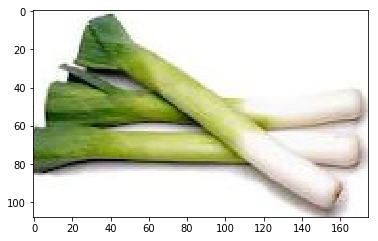

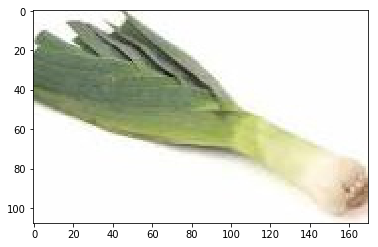

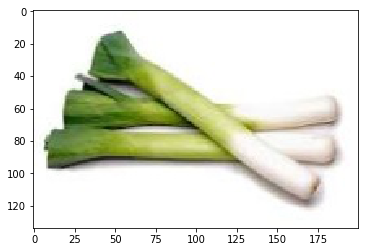

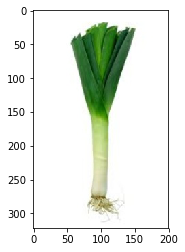

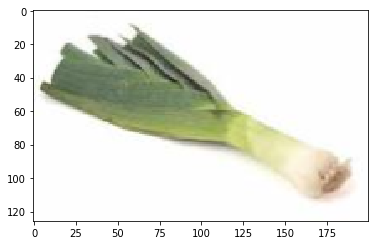

In [70]:
showImg(fillDF[fillDF['ProdName']=='LEEK'])

In [71]:
np.sort(fillDF['ProdName'].unique())

array(['APPLE', 'APRICOT', 'AUBERGINE', 'AVOCADO', 'BANANA', 'BEAN',
       'BEETROOT', 'BREAD', 'BUN', 'CABBAGE', 'CARROT', 'CAULIFLOWER',
       'CHEESE', 'CHERRY', 'CHILI', 'COCONUT', 'CORN', 'CUCUMBER',
       'DATES', 'DOUGHNUT', 'EGG', 'FIG', 'FIRED', 'FRIEDCHICKEN',
       'GARLIC', 'GINGER', 'GRAPE', 'GRAPEFRUIT', 'GUAVA', 'KIWI', 'LEEK',
       'LEMON', 'LENTILS', 'LETTUCE', 'LITCHI', 'MANDARIN', 'MANGO',
       'MELON', 'MOONCAKE', 'MUSHROOMS', 'OKRA', 'OLIVE', 'ONION',
       'ORANGE', 'PAPAYA', 'PASTA', 'PEACH', 'PEAR', 'PEPPER',
       'PINEAPPLE', 'PLUM', 'POMEGRANATE', 'POTATO', 'QIWI', 'RADISH',
       'RASPBERRY', 'RICE', 'SACHIMA', 'SAUCE', 'SPINACH', 'STRAWBERRY',
       'SWEET', 'TOMATO', 'WATERMELON', 'WHITE', 'ZUCCHINI'], dtype=object)

In [72]:
fillDF['ProdName'].value_counts()

APPLE           856
ORANGE          523
TOMATO          455
EGG             376
ONION           360
BREAD           338
BANANA          297
BEAN            279
CHEESE          259
MANGO           229
GRAPE           227
SAUCE           210
DOUGHNUT        210
PASTA           207
LEMON           193
PEAR            184
QIWI            181
PLUM            176
SACHIMA         150
PEACH           137
MOONCAKE        134
CUCUMBER        130
FIRED           124
CARROT          106
PEPPER          100
BUN              90
WATERMELON       80
LITCHI           78
APRICOT          69
GRAPEFRUIT       63
               ... 
CABBAGE          21
SWEET            18
DATES            18
AUBERGINE        18
RADISH           17
PINEAPPLE        15
GARLIC           15
COCONUT          14
MUSHROOMS        14
ZUCCHINI         13
GUAVA            12
CAULIFLOWER      10
CHILI            10
GINGER            9
CHERRY            9
STRAWBERRY        9
CORN              7
FIG               7
WHITE             7


In [74]:
fillDF.describe()

,FullSize2D,Height,Width,Ratio
count,7314.000000,7314.000000,7314.000000,7314.000000
mean,29003.925349,147.566585,193.951463,1.448672
std,10240.881435,45.820436,26.469252,0.231979
min,196.000000,14.000000,14.000000,1.000000
25%,22600.000000,113.000000,200.000000,1.333333
50%,30000.000000,150.000000,200.000000,1.333333
75%,30000.000000,150.000000,200.000000,1.769912
max,139502.000000,373.000000,374.000000,3.400000


In [77]:
type(np.array(fillDF['ImageArray'][0]))

numpy.ndarray

In [78]:
np.array(fillDF['ImageArray'][0]).shape

(112, 200, 3)

In [79]:
fillDF['ImageArray_nump'] = fillDF['ImageArray'].apply(lambda x: np.array(x))
fillDF.head()

,Path,FileName,ImageArray,FullSize2D,Height,Width,Ratio,W/o common,ProdName,ImageArray_nump
0,D:\PROGRAMMING_PROJS\FooDMachineLearning\compl...,0_PROGRAMMING_PROJS_FooDMachineLearning_FooDD_...,"[[[95, 88, 59], [109, 102, 74], [113, 106, 80]...",22400,112,200,1.785714,Apple_1-Samsung-S4-Light__Environment_1__(1)_j...,APPLE,"[[[95, 88, 59], [109, 102, 74], [113, 106, 80]..."
1,D:\PROGRAMMING_PROJS\FooDMachineLearning\compl...,1000_PROGRAMMING_PROJS_FooDMachineLearning_Foo...,"[[[59, 39, 30], [67, 47, 36], [65, 43, 30], [6...",30000,150,200,1.333333,Bread_3-IOS-4-Light__Environment_3__(60)_jpg3_...,BREAD,"[[[59, 39, 30], [67, 47, 36], [65, 43, 30], [6..."
2,D:\PROGRAMMING_PROJS\FooDMachineLearning\compl...,1001_PROGRAMMING_PROJS_FooDMachineLearning_Foo...,"[[[113, 112, 108], [102, 101, 99], [106, 105, ...",30000,150,200,1.333333,Bread_3-IOS-4-Light__Environment_3__(61)_jpg3_...,BREAD,"[[[113, 112, 108], [102, 101, 99], [106, 105, ..."
3,D:\PROGRAMMING_PROJS\FooDMachineLearning\compl...,1002_PROGRAMMING_PROJS_FooDMachineLearning_Foo...,"[[[206, 210, 222], [207, 211, 223], [206, 210,...",30000,150,200,1.333333,Bread_3-IOS-4-Light__Environment_3__(62)_jpg3_...,BREAD,"[[[206, 210, 222], [207, 211, 223], [206, 210,..."
4,D:\PROGRAMMING_PROJS\FooDMachineLearning\compl...,1003_PROGRAMMING_PROJS_FooDMachineLearning_Foo...,"[[[172, 179, 187], [193, 200, 208], [199, 206,...",30000,150,200,1.333333,Bread_3-IOS-4-Light__Environment_3__(63)_jpg3_...,BREAD,"[[[172, 179, 187], [193, 200, 208], [199, 206,..."


In [80]:
fillDF.drop_duplicates(subset = 'ImageArray_nump', inplace = True)
fillDF.describe()

TypeError: unhashable type: 'numpy.ndarray'

In [81]:
fillDF = fillDF[~fillDF['ImageArray'].apply(tuple).duplicated(keep='first')]
fillDF.describe()

,FullSize2D,Height,Width,Ratio
count,7314.000000,7314.000000,7314.000000,7314.000000
mean,29003.925349,147.566585,193.951463,1.448672
std,10240.881435,45.820436,26.469252,0.231979
min,196.000000,14.000000,14.000000,1.000000
25%,22600.000000,113.000000,200.000000,1.333333
50%,30000.000000,150.000000,200.000000,1.333333
75%,30000.000000,150.000000,200.000000,1.769912
max,139502.000000,373.000000,374.000000,3.400000


In [83]:
fillDF = fillDF[~fillDF['ImageArray_nump'].apply(str).duplicated(keep='first')]
fillDF.describe()

,FullSize2D,Height,Width,Ratio
count,6141.000000,6141.000000,6141.000000,6141.000000
mean,28928.862563,147.234489,193.875916,1.427937
std,9381.904604,41.885839,26.260371,0.214961
min,196.000000,14.000000,14.000000,1.000000
25%,22600.000000,113.000000,200.000000,1.333333
50%,30000.000000,150.000000,200.000000,1.333333
75%,30000.000000,150.000000,200.000000,1.387387
max,139502.000000,373.000000,374.000000,3.400000


In [84]:
fillDF['ProdName'].value_counts()

APPLE           593
ORANGE          516
ONION           341
EGG             335
TOMATO          332
BREAD           287
CHEESE          244
MANGO           225
BEAN            224
DOUGHNUT        210
SAUCE           210
BANANA          206
PASTA           198
GRAPE           197
LEMON           184
PEAR            178
PLUM            176
SACHIMA         150
QIWI            150
MOONCAKE        134
PEACH           133
FIRED           124
BUN              90
LITCHI           78
PEPPER           61
GRAPEFRUIT       53
CARROT           46
WATERMELON       43
CUCUMBER         40
OLIVE            38
               ... 
KIWI             20
DATES            17
AUBERGINE        15
SWEET            15
MELON            13
RADISH           13
COCONUT          11
MUSHROOMS        11
GUAVA            10
GARLIC            9
ZUCCHINI          9
CABBAGE           9
PINEAPPLE         8
CHERRY            8
WHITE             7
CORN              6
GINGER            6
CHILI             6
STRAWBERRY        5


In [86]:
fillDF.to_pickle('raw_food_df')

# Decreasing Dataset's imbalance

In [1]:
import pandas as pd
rawDF = pd.read_pickle('raw_food_df')
rawDF.head()

,Path,FileName,ImageArray,FullSize2D,Height,Width,Ratio,W/o common,ProdName,ImageArray_nump
0,D:\PROGRAMMING_PROJS\FooDMachineLearning\compl...,0_PROGRAMMING_PROJS_FooDMachineLearning_FooDD_...,"[[[95, 88, 59], [109, 102, 74], [113, 106, 80]...",22400,112,200,1.785714,Apple_1-Samsung-S4-Light__Environment_1__(1)_j...,APPLE,"[[[95, 88, 59], [109, 102, 74], [113, 106, 80]..."
1,D:\PROGRAMMING_PROJS\FooDMachineLearning\compl...,1000_PROGRAMMING_PROJS_FooDMachineLearning_Foo...,"[[[59, 39, 30], [67, 47, 36], [65, 43, 30], [6...",30000,150,200,1.333333,Bread_3-IOS-4-Light__Environment_3__(60)_jpg3_...,BREAD,"[[[59, 39, 30], [67, 47, 36], [65, 43, 30], [6..."
2,D:\PROGRAMMING_PROJS\FooDMachineLearning\compl...,1001_PROGRAMMING_PROJS_FooDMachineLearning_Foo...,"[[[113, 112, 108], [102, 101, 99], [106, 105, ...",30000,150,200,1.333333,Bread_3-IOS-4-Light__Environment_3__(61)_jpg3_...,BREAD,"[[[113, 112, 108], [102, 101, 99], [106, 105, ..."
3,D:\PROGRAMMING_PROJS\FooDMachineLearning\compl...,1002_PROGRAMMING_PROJS_FooDMachineLearning_Foo...,"[[[206, 210, 222], [207, 211, 223], [206, 210,...",30000,150,200,1.333333,Bread_3-IOS-4-Light__Environment_3__(62)_jpg3_...,BREAD,"[[[206, 210, 222], [207, 211, 223], [206, 210,..."
4,D:\PROGRAMMING_PROJS\FooDMachineLearning\compl...,1003_PROGRAMMING_PROJS_FooDMachineLearning_Foo...,"[[[172, 179, 187], [193, 200, 208], [199, 206,...",30000,150,200,1.333333,Bread_3-IOS-4-Light__Environment_3__(63)_jpg3_...,BREAD,"[[[172, 179, 187], [193, 200, 208], [199, 206,..."


In [2]:
rawDF.describe()

,FullSize2D,Height,Width,Ratio
count,6141.000000,6141.000000,6141.000000,6141.000000
mean,28928.862563,147.234489,193.875916,1.427937
std,9381.904604,41.885839,26.260371,0.214961
min,196.000000,14.000000,14.000000,1.000000
25%,22600.000000,113.000000,200.000000,1.333333
50%,30000.000000,150.000000,200.000000,1.333333
75%,30000.000000,150.000000,200.000000,1.387387
max,139502.000000,373.000000,374.000000,3.400000


In [3]:
rawDF['ProdName'].unique().shape

(64,)

In [4]:
rawDF.shape

(6141, 10)

In [5]:
rawDF.shape[0]/rawDF['ProdName'].unique().shape[0]

95.953125

In [6]:
rawDF['ProdName'].value_counts()

APPLE           593
ORANGE          516
ONION           341
EGG             335
TOMATO          332
BREAD           287
CHEESE          244
MANGO           225
BEAN            224
DOUGHNUT        210
SAUCE           210
BANANA          206
PASTA           198
GRAPE           197
LEMON           184
PEAR            178
PLUM            176
QIWI            150
SACHIMA         150
MOONCAKE        134
PEACH           133
FIRED           124
BUN              90
LITCHI           78
PEPPER           61
GRAPEFRUIT       53
CARROT           46
WATERMELON       43
CUCUMBER         40
OLIVE            38
               ... 
KIWI             20
DATES            17
SWEET            15
AUBERGINE        15
RADISH           13
MELON            13
COCONUT          11
MUSHROOMS        11
GUAVA            10
GARLIC            9
CABBAGE           9
ZUCCHINI          9
CHERRY            8
PINEAPPLE         8
WHITE             7
CORN              6
GINGER            6
CHILI             6
LENTILS           5


In [7]:
rawDF['ProdName'].value_counts().describe()

count     64.000000
mean      95.953125
std      128.781275
min        1.000000
25%        7.750000
50%       30.000000
75%      176.500000
max      593.000000
Name: ProdName, dtype: float64

Dataset would be "perfectly" balanced if each class contained approximately 96 records. However, cardinality of classes reaches from 1 (ex. for RICE) to 593 (APPLE). Because data is presented as image, we can forge new samples by rotating/flipping images. In order to decrease imbalance <span style="color:red">>>TODO<<</span>

In [8]:
import pandas as pd
import numpy as np
import os
from os.path import isfile, join
import shutil
from tqdm import tqdm
import time
from imageio import imread

# Scaling/padding of images

In [9]:
rawDF[['FullSize2D','Height','Width','Ratio']].describe()

,FullSize2D,Height,Width,Ratio
count,6141.000000,6141.000000,6141.000000,6141.000000
mean,28928.862563,147.234489,193.875916,1.427937
std,9381.904604,41.885839,26.260371,0.214961
min,196.000000,14.000000,14.000000,1.000000
25%,22600.000000,113.000000,200.000000,1.333333
50%,30000.000000,150.000000,200.000000,1.333333
75%,30000.000000,150.000000,200.000000,1.387387
max,139502.000000,373.000000,374.000000,3.400000


In [10]:
type(rawDF['ImageArray'][0])

imageio.core.util.Image

In [11]:
from skimage.transform import resize
from matplotlib import pyplot as plt
pp=np.array(rawDF['ImageArray'][0])
print((pp.shape))
plt.imshow(resize(pp,(200,200,3)))#.shape
plt.show()

(112, 200, 3)


C:\Users\AdamT\Anaconda3\envs\foodmlenv\lib\site-packages\skimage\transform\_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
C:\Users\AdamT\Anaconda3\envs\foodmlenv\lib\site-packages\skimage\transform\_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "


<Figure size 640x480 with 1 Axes>

In [12]:
def unifySize(mode):
    if mode == 'basic':
        rawDF['ImageArray'] = rawDF['ImageArray'].apply(lambda x: resize(x[0],(147,193,3)))

In [13]:
unifySize('basic')

C:\Users\AdamT\Anaconda3\envs\foodmlenv\lib\site-packages\skimage\transform\_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
C:\Users\AdamT\Anaconda3\envs\foodmlenv\lib\site-packages\skimage\transform\_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "


In [14]:
pp=np.array(rawDF['ImageArray'][0])
print((pp.shape))

(147, 193, 3)


In [15]:
rawDF['ImageArray'] = rawDF['ImageArray'].apply(lambda x: resize(x[0],(147,193,3)))


C:\Users\AdamT\Anaconda3\envs\foodmlenv\lib\site-packages\skimage\transform\_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
C:\Users\AdamT\Anaconda3\envs\foodmlenv\lib\site-packages\skimage\transform\_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "


In [16]:
pp=np.array(rawDF['ImageArray'][11])
print((pp.shape))

(147, 193, 3)


In [17]:
rawDF.head()

,Path,FileName,ImageArray,FullSize2D,Height,Width,Ratio,W/o common,ProdName,ImageArray_nump
0,D:\PROGRAMMING_PROJS\FooDMachineLearning\compl...,0_PROGRAMMING_PROJS_FooDMachineLearning_FooDD_...,"[[[0.0, 0.0, 0.0], [0.0, 0.0, 0.0], [0.0, 0.0,...",22400,112,200,1.785714,Apple_1-Samsung-S4-Light__Environment_1__(1)_j...,APPLE,"[[[95, 88, 59], [109, 102, 74], [113, 106, 80]..."
1,D:\PROGRAMMING_PROJS\FooDMachineLearning\compl...,1000_PROGRAMMING_PROJS_FooDMachineLearning_Foo...,"[[[0.0, 0.0, 0.0], [0.0, 0.0, 0.0], [0.0, 0.0,...",30000,150,200,1.333333,Bread_3-IOS-4-Light__Environment_3__(60)_jpg3_...,BREAD,"[[[59, 39, 30], [67, 47, 36], [65, 43, 30], [6..."
2,D:\PROGRAMMING_PROJS\FooDMachineLearning\compl...,1001_PROGRAMMING_PROJS_FooDMachineLearning_Foo...,"[[[0.0, 0.0, 0.0], [0.0, 0.0, 0.0], [0.0, 0.0,...",30000,150,200,1.333333,Bread_3-IOS-4-Light__Environment_3__(61)_jpg3_...,BREAD,"[[[113, 112, 108], [102, 101, 99], [106, 105, ..."
3,D:\PROGRAMMING_PROJS\FooDMachineLearning\compl...,1002_PROGRAMMING_PROJS_FooDMachineLearning_Foo...,"[[[0.0, 0.0, 0.0], [0.0, 0.0, 0.0], [0.0, 0.0,...",30000,150,200,1.333333,Bread_3-IOS-4-Light__Environment_3__(62)_jpg3_...,BREAD,"[[[206, 210, 222], [207, 211, 223], [206, 210,..."
4,D:\PROGRAMMING_PROJS\FooDMachineLearning\compl...,1003_PROGRAMMING_PROJS_FooDMachineLearning_Foo...,"[[[0.0, 0.0, 0.0], [0.0, 0.0, 0.0], [0.0, 0.0,...",30000,150,200,1.333333,Bread_3-IOS-4-Light__Environment_3__(63)_jpg3_...,BREAD,"[[[172, 179, 187], [193, 200, 208], [199, 206,..."


In [18]:
FlatImgs = rawDF['ImageArray'].apply(lambda x: x.flatten())
FlatImgs.shape

(6141,)

In [19]:
FlatImgs[0].shape

(85113,)

In [20]:
147*193*3

85113

In [22]:
FlatArr = np.array([i for i in FlatImgs])
FlatArr.shape

(6141, 85113)

In [24]:
np.sum(np.sum(FlatArr))

17762775.14856649

In [26]:
flarrDF = pd.DataFrame(data = FlatArr)
flarrDF

,0,1,2,3,4,5,6,7,8,9,...,85103,85104,85105,85106,85107,85108,85109,85110,85111,85112
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
7,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
9,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [32]:
flarrDF.sum(axis=0).sort_values(ascending = False)

14764    3211.334190
15343    3203.005475
15922    3194.676760
16501    3186.348045
17080    3178.019329
17659    3169.690614
14767    3161.417078
14761    3161.417078
18238    3161.361899
15346    3153.217825
15340    3153.217825
18817    3153.033184
15919    3145.018572
15925    3145.018572
19396    3144.704469
16498    3136.819318
16504    3136.819318
19975    3136.375754
17083    3128.620065
17077    3128.620065
20554    3128.047038
17656    3120.420812
17662    3120.420812
21133    3119.718323
18235    3112.221559
18241    3112.221559
14770    3111.499966
14758    3111.499966
21712    3111.389608
18820    3104.022305
            ...     
55673       0.000000
55674       0.000000
55675       0.000000
55676       0.000000
55677       0.000000
55678       0.000000
55679       0.000000
55680       0.000000
55682       0.000000
55683       0.000000
55667       0.000000
55665       0.000000
55648       0.000000
55664       0.000000
55649       0.000000
55650       0.000000
55651       0

In [34]:
flarrDF['Path'] = rawDF['Path']
flarrDF['Orginal_Image_Size'] = rawDF['FullSize2D']
flarrDF['Orginal_Image_Height'] = rawDF['Height']
flarrDF['Orginal_Image_Width'] = rawDF['Width']
flarrDF['Orginal_Image_Ratio'] = rawDF['Ratio']
flarrDF['Product_Name'] = rawDF['ProdName']

In [35]:
flarrDF.head()

,0,1,2,3,4,5,6,7,8,9,...,85109,85110,85111,85112,Path,Orginal_Image_Size,Orginal_Image_Height,Orginal_Image_Width,Orginal_Image_Ratio,Product_Name
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,D:\PROGRAMMING_PROJS\FooDMachineLearning\compl...,22400.0,112.0,200.0,1.785714,APPLE
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,D:\PROGRAMMING_PROJS\FooDMachineLearning\compl...,30000.0,150.0,200.0,1.333333,BREAD
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,D:\PROGRAMMING_PROJS\FooDMachineLearning\compl...,30000.0,150.0,200.0,1.333333,BREAD
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,D:\PROGRAMMING_PROJS\FooDMachineLearning\compl...,30000.0,150.0,200.0,1.333333,BREAD
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,D:\PROGRAMMING_PROJS\FooDMachineLearning\compl...,30000.0,150.0,200.0,1.333333,BREAD


In [36]:
flarrDF.to_pickle('ALL_PIXELS_DF')

Columns with low variance will probably be unnecessary, so we'll get rid of them before proceding further.